In [1]:
import torch
import torch.optim as optim
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import sklearn
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import csv
import math
import scipy

import dataset
import datasplit
import model.models as models
import trainer
import utils


# TEST on MONO CONTINUOUS


In [2]:
# LOAD
# folders
models_folder = '../../models_and_results/models'
model_name = '20201020_setnetcond_mono_cont_best'
results_folder = '../../models_and_results/results'
results_subfolder = '20201020_setnetcond_mono_cont'

# model
setnetcond = torch.load('%s/%s' % (models_folder, model_name), map_location=torch.device('cpu'))

# results
all_train_losses = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_train_losses.npy')), allow_pickle=True)
all_train_correct = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_train_correct.npy')), allow_pickle=True)
best_train_results = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'best_train_results.npy')), allow_pickle=True)

all_val_losses = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_val_losses.npy')), allow_pickle=True)
all_val_correct = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_val_correct.npy')), allow_pickle=True)
best_val_results = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'best_val_results.npy')), allow_pickle=True)

all_test_losses = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_test_losses.npy')), allow_pickle=True)
all_test_correct = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'all_test_correct.npy')), allow_pickle=True)
best_test_results = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'best_test_results.npy')), allow_pickle=True)

fx_labels = np.load(file=('%s/%s/%s' % (results_folder, results_subfolder, 'fx_labels.npy')), allow_pickle=True)

# datasets sizes
train_set_size = best_train_results.shape[0]
val_set_size = best_val_results.shape[0]
test_set_size = best_test_results.shape[0]

# example
best_train_results[0]

array([78368, 'G93-40100-OD1-D8.5-21139',
       array([ 1.   ,  0.902, -1.   ], dtype=float32),
       array([ 1.  ,  0.85, -1.  ], dtype=float32)], dtype=object)

In [3]:
# # BEST RESULTS
# print('Best Train Accuracy: ', 100 * max(all_train_correct) / train_set_size)
# print('Epoch: ', np.argmax(all_train_correct))
# print()
# print('Best Val Accuracy: ', 100 * max(all_val_correct) / val_set_size)
# print('Epoch: ', np.argmax(all_val_correct))
# print()
# print('Best Test Accuracy: ', 100 * max(all_test_correct) / test_set_size)
# print('Epoch: ', np.argmax(all_test_correct))
# print()

# # LOSS
# epochs = range(0, len(all_train_losses))
# plt.figure(figsize=(8,6))
# plt.grid(b=None, which='major', axis='both')
# plt.plot(epochs, all_train_losses, 'b', label='Train loss')
# plt.plot(epochs, all_val_losses, 'r', label='Validation loss')
# plt.plot(epochs, all_test_losses, 'g', label='Test loss')
# plt.title('Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

# # NORMALISED LOSS
# epochs = range(0, len(all_train_losses))
# plt.figure(figsize=(8,6))
# plt.grid(b=None, which='major', axis='both')
# plt.plot(epochs, np.array(all_train_losses) / max(all_train_losses), 'b', label='Train loss')
# plt.plot(epochs, np.array(all_val_losses) / max(all_val_losses), 'r', label='Validation loss')
# plt.plot(epochs, np.array(all_test_losses) / max(all_test_losses), 'g', label='Test loss')
# plt.title('Normalised Loss')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

# # ACCURACY
# all_train_perc_correct = 100 * np.array(all_train_correct) / train_set_size
# all_val_perc_correct = 100 * np.array(all_val_correct) / val_set_size
# all_test_perc_correct = 100 * np.array(all_test_correct) / test_set_size
# epochs = range(0, len(all_train_losses))
# plt.figure(figsize=(8,6))
# plt.grid(b=None, which='major', axis='both')
# plt.plot(epochs, all_train_perc_correct, 'b', label='Train acc')
# plt.plot(epochs, all_val_perc_correct, 'r', label='Validation acc')
# plt.plot(epochs, all_test_perc_correct, 'g', label='Test acc')
# plt.title('Accuracy')
# plt.xlabel('Epochs')
# plt.ylabel('Loss')
# plt.legend()
# plt.show()

In [4]:
# DATAFRAME
test_indexes_mono_cont = best_test_results[:, 0]
test_filenames_mono_cont = best_test_results[:, 1] 
test_preds_mono_cont = np.stack(best_test_results[:, 2])
test_targets_mono_cont = np.stack(best_test_results[:, 3])
test_abs_err_mono_cont = np.stack(abs(test_preds_mono_cont - test_targets_mono_cont))
test_err_mono_cont = np.stack(test_preds_mono_cont - test_targets_mono_cont)

test_df_mono_cont = pd.DataFrame(data={
    'index': test_indexes_mono_cont, 
    'filename': test_filenames_mono_cont,
    'level_pred': test_preds_mono_cont[:,0], 
    'gain_pred': test_preds_mono_cont[:,1],
    'tone_eq1_pred': test_preds_mono_cont[:,2], 
    'level_targ': test_targets_mono_cont[:,0], 
    'gain_targ': test_targets_mono_cont[:,1],
    'tone_eq1_targ': test_targets_mono_cont[:,2], 
    'level_err': test_err_mono_cont[:,0], 
    'gain_err': test_err_mono_cont[:,1],
    'tone_eq1_err': test_err_mono_cont[:,2], 
    'level_abs': test_abs_err_mono_cont[:,0], 
    'gain_abs': test_abs_err_mono_cont[:,1],
    'tone_eq1_abs': test_abs_err_mono_cont[:,2], 
})

print(len(test_df_mono_cont))
test_df_mono_cont[:3]

26000


,index,filename,level_pred,gain_pred,tone_eq1_pred,level_targ,gain_targ,tone_eq1_targ,level_err,gain_err,tone_eq1_err,level_abs,gain_abs,tone_eq1_abs
0,70865,G63-62407-OD1-D7-20717,1.0,0.697,-1.000,1.0,0.70,-1.00,0.0,-0.003,0.000,0.0,0.003,0.000
1,1715,G93-52112-808-O2.3T2.1-21151,1.0,0.306,0.655,1.0,0.23,0.21,0.0,0.076,0.445,0.0,0.076,0.445
2,118938,G81-64409-TS9-D6.4T8.8-20953,1.0,0.642,0.584,1.0,0.64,0.88,0.0,0.002,-0.296,0.0,0.002,0.296


In [5]:
# MAE
level_mae_mono_cont = sum(test_df_mono_cont.level_abs)/test_set_size
gain_mae_mono_cont = sum(test_df_mono_cont.gain_abs)/test_set_size
tone_eq1_mae_mono_cont = sum(test_df_mono_cont.tone_eq1_abs)/test_set_size

print('level_mae: ', level_mae_mono_cont)
print('gain_mae: ', gain_mae_mono_cont)
print('tone_eq1_mae: ', tone_eq1_mae_mono_cont)

# RMSE
level_rmse_mono_cont = math.sqrt(sum(test_df_mono_cont.level_abs**2)/test_set_size)
gain_rmse_mono_cont = math.sqrt(sum(test_df_mono_cont.gain_abs**2)/test_set_size)
tone_eq1_rmse_mono_cont = math.sqrt(sum(test_df_mono_cont.tone_eq1_abs**2)/test_set_size)

print('level_rmse: ', level_rmse_mono_cont)
print('gain_rmse: ', gain_rmse_mono_cont)
print('tone_eq1_rmse: ', tone_eq1_rmse_mono_cont)

level_mae:  1.4230746489304762e-06
gain_mae:  0.03266200043090458
tone_eq1_mae:  0.0390579617091168
level_rmse:  0.00014504623525361877
gain_rmse:  0.0453292448659154
tone_eq1_rmse:  0.07172154953325116


[(-0.22, 0.22)]

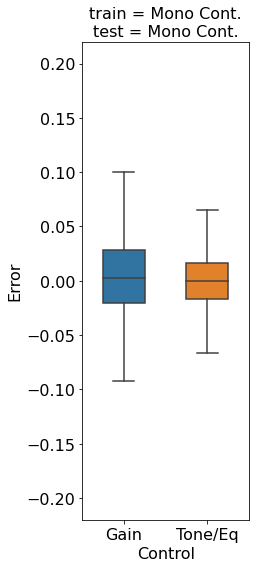

In [6]:
# BOX PLOT
err_df_mono_cont = pd.DataFrame(data={
    'Gain': test_df_mono_cont['gain_err'],
    'Tone/Eq': test_df_mono_cont['tone_eq1_err'],
})

plt.figure(figsize=(3.8,8))
ax = utils.box_plot(error_dataframe=err_df_mono_cont, title='train = Mono Cont.\ntest = Mono Cont.', title_fontsize=16, text_fontsize=16)
ax.set(ylim=(-0.22,0.22))
# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnetcond_bp_MC_MC.eps'), format='eps')

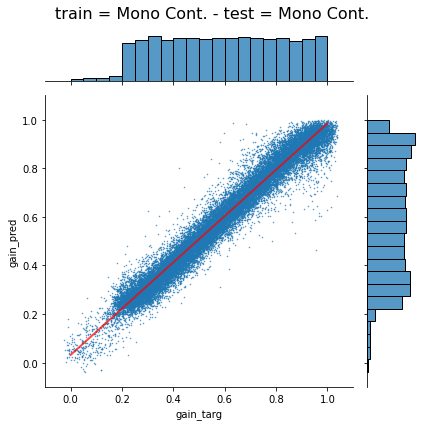

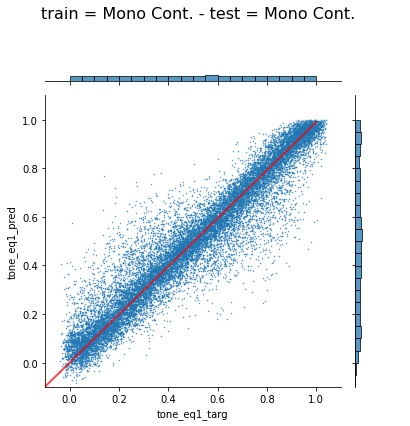

In [8]:
# SCATTER PLOT
# gain
ax = utils.scatter_plot(
    x="gain_targ", y="gain_pred", dataframe=test_df_mono_cont, 
    title='train = Mono Cont. - test = Mono Cont.', title_fontsize=16, 
    text_fontsize=16, xlabel='Gain - Target', ylabel='Gain - Pred'
)

ax.ax_marg_x.set_xlim(-0.1, 1.1)
ax.ax_marg_y.set_ylim(-0.1, 1.1)

# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnetcond_sp_gain_MC_MC.jpg'), dpi=500, format='jpg')

# tone/eq1
ax = utils.scatter_plot(
    x="tone_eq1_targ", y="tone_eq1_pred", dataframe=test_df_mono_cont, 
    title='train = Mono Cont. - test = Mono Cont.', title_fontsize=16, 
    text_fontsize=16, xlabel='Tone/Eq - Target', ylabel='Tone/Eq - Pred',
    bins=40
)

ax.ax_marg_x.set_xlim(-0.1, 1.1)
ax.ax_marg_y.set_ylim(-0.1, 1.1)

# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnetcond_sp_tone_MC_MC.jpg'), dpi=500, format='jpg')

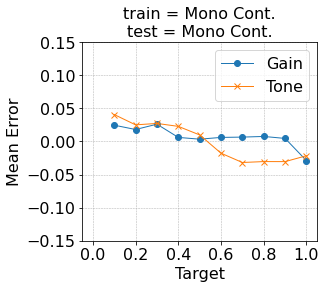

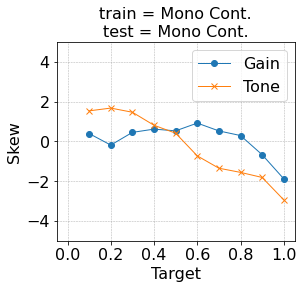

In [19]:
# MEAN ERROR and SKEW PLOT
step_size = 0.1
steps = np.linspace(start=0, stop=1, num=int(1/step_size + 1))
avg_err_gain = []
avg_err_tone = []
skew_gain = []
skew_tone = []

for n in range(len(steps)-1):
    df = test_df_mono_cont[(test_df_mono_cont['gain_targ'] >= steps[n]) & (test_df_mono_cont['gain_targ'] < steps[n+1])]
    avg_err_gain.append(sum(df['gain_err']) / len(df))
    skew_gain.append(scipy.stats.skew(df['gain_err']))

for n in range(len(steps)-1):
    df = test_df_mono_cont[(test_df_mono_cont['tone_eq1_targ'] >= steps[n]) & (test_df_mono_cont['tone_eq1_targ'] < steps[n+1])]
    avg_err_tone.append(sum(df['tone_eq1_err']) / len(df))
    skew_tone.append(scipy.stats.skew(df['tone_eq1_err']))

# print(np.around(avg_err_gain,3))
# print(np.around(avg_err_tone,3))

# mean error
plt.figure(figsize=(4.8,4.3))
utils.line_plot(
    x_gain=steps[1:], x_tone=steps[1:], 
    y_gain=avg_err_gain, y_tone=avg_err_tone, 
    title='train = Mono Cont.\ntest = Mono Cont.' , title_fontsize=16, 
    text_fontsize=16, xlabel='Target', ylabel='Mean Error'
)

plt.xlim([-0.05, 1.05])
plt.ylim([-0.15, 0.15])
# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnetcond_me_MC_MC.eps'), format='eps')

# skew
plt.figure(figsize=(4.5,4.3))
ax = utils.line_plot(
    x_gain=steps[1:], x_tone=steps[1:], 
    y_gain=skew_gain, y_tone=skew_tone, 
    title='train = Mono Cont.\ntest = Mono Cont.' , title_fontsize=16, 
    text_fontsize=16, xlabel='Target', ylabel='Skew'
)

plt.xlim([-0.05, 1.05])
plt.ylim([-5, 5])
# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnetcond_sk_MC_MC.eps'), format='eps')

# TEST on MONO DISCRETE

In [9]:
# PREPARE
# dataset
dataset_mono_disc = dataset.FxDataset(
    root='/Volumes/Macintosh HD/DATASETS/GUITAR-FX/Mono_Discrete',
    excl_folders=['MT2'], 
    spectra_folder='mel_22050_1024_512', 
    processed_settings_csv='proc_settings.csv',
    max_num_settings=3,
    transform=transforms.Compose([transforms.ToTensor()])
)

dataset_mono_disc.init_dataset()
# dataset_mono_rnd.generate_mel()

# split
# set test_train_split=0.0 and val_train_split=0.0 to test pre-trained model
split_mono_disc = datasplit.DataSplit(dataset_mono_disc, test_train_split=0.0, val_train_split=0.0, shuffle=True)

# loaders
_, _, test_loader_mono_disc = split_mono_disc.get_split(batch_size=100)

len(dataset_mono_disc)

123552

In [10]:
# TEST
test_mono_disc_loss, test_mono_disc_correct, test_mono_disc_results = trainer.test_settings_cond_net(
    model=setnetcond, 
    test_loader=test_loader_mono_disc, 
    test_sampler=split_mono_disc.test_sampler,
    loss_function=nn.MSELoss(), 
    device='cpu'
)

# example
test_mono_disc_results[0]

====> Test Loss: 8.6118	 Avg Loss: 0.0001	Correct: 84640/123552	Percentage Correct: 68.51


(37200,
 'G71-62312-BMF-S5T8-20787',
 array([1.   , 0.559, 0.795], dtype=float32),
 array([1. , 0.5, 0.8], dtype=float32))

In [11]:
# DATAFRAME
test_results_npy_mono_disc = np.array(test_mono_disc_results)
test_indexes_mono_disc = test_results_npy_mono_disc[:, 0]
test_filenames_mono_disc = test_results_npy_mono_disc[:, 1] 
test_preds_mono_disc = np.stack(test_results_npy_mono_disc[:, 2])
test_targets_mono_disc = np.stack(test_results_npy_mono_disc[:, 3])
test_abs_err_mono_disc = np.stack(abs(test_preds_mono_disc - test_targets_mono_disc))
test_err_mono_disc = np.stack(test_preds_mono_disc - test_targets_mono_disc)

test_df_mono_disc = pd.DataFrame(data={
    'index': test_indexes_mono_disc, 
    'filename': test_filenames_mono_disc,
    'level_pred': test_preds_mono_disc[:,0], 
    'gain_pred': test_preds_mono_disc[:,1],
    'tone_eq1_pred': test_preds_mono_disc[:,2], 
    'level_targ': test_targets_mono_disc[:,0], 
    'gain_targ': test_targets_mono_disc[:,1],
    'tone_eq1_targ': test_targets_mono_disc[:,2], 
    'level_err': test_err_mono_disc[:,0], 
    'gain_err': test_err_mono_disc[:,1],
    'tone_eq1_err': test_err_mono_disc[:,2], 
    'level_abs': test_abs_err_mono_disc[:,0], 
    'gain_abs': test_abs_err_mono_disc[:,1],
    'tone_eq1_abs': test_abs_err_mono_disc[:,2], 
})

print(len(test_df_mono_disc))
test_df_mono_disc[:3]

123552


,index,filename,level_pred,gain_pred,tone_eq1_pred,level_targ,gain_targ,tone_eq1_targ,level_err,gain_err,tone_eq1_err,level_abs,gain_abs,tone_eq1_abs
0,37200,G71-62312-BMF-S5T8-20787,1.0,0.559,0.795,1.0,0.5,0.8,0.0,0.059,-0.005,0.0,0.059,0.005
1,36476,G93-52207-BMF-S10T2-21159,1.0,0.938,0.135,1.0,1.0,0.2,0.0,-0.062,-0.065,0.0,0.062,0.065
2,13216,G83-55305-BD2-G5T10-21014,1.0,0.932,0.939,1.0,0.5,1.0,0.0,0.432,-0.061,0.0,0.432,0.061


In [12]:
# MAE
level_mae_mono_disc = sum(test_df_mono_disc.level_abs)/len(test_df_mono_disc)
gain_mae_mono_disc = sum(test_df_mono_disc.gain_abs)/len(test_df_mono_disc)
tone_eq1_mae_mono_disc = sum(test_df_mono_disc.tone_eq1_abs)/len(test_df_mono_disc)

print('level_mae: ', level_mae_mono_disc)
print('gain_mae: ', gain_mae_mono_disc)
print('tone_eq1_mae: ', tone_eq1_mae_mono_disc)

# RMSE
level_rmse_mono_disc = math.sqrt(sum(test_df_mono_disc.level_abs**2)/len(test_df_mono_disc))
gain_rmse_mono_disc = math.sqrt(sum(test_df_mono_disc.gain_abs**2)/len(test_df_mono_disc))
tone_eq1_rmse_mono_disc = math.sqrt(sum(test_df_mono_disc.tone_eq1_abs**2)/len(test_df_mono_disc))

print('level_rmse: ', level_rmse_mono_disc)
print('gain_rmse: ', gain_rmse_mono_disc)
print('tone_eq1_rmse: ', tone_eq1_rmse_mono_disc)

level_mae:  6.685437230797081e-06
gain_mae:  0.06178760240707048
tone_eq1_mae:  0.06647612359908238
level_rmse:  0.0003386328043826218
gain_rmse:  0.09573199415107093
tone_eq1_rmse:  0.10832880942703102


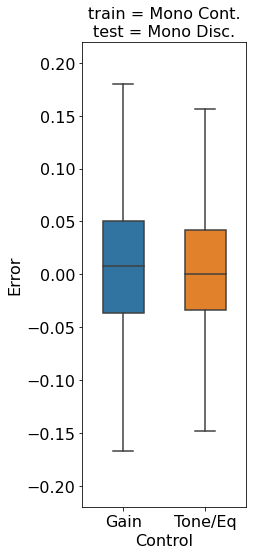

In [13]:
# BOX PLOT
err_df_mono_disc = pd.DataFrame(data={
    'Gain': test_df_mono_disc['gain_err'],
    'Tone/Eq': test_df_mono_disc['tone_eq1_err'],
})

plt.figure(figsize=(3.8,8))
ax = utils.box_plot(error_dataframe=err_df_mono_disc, title='train = Mono Cont.\ntest = Mono Disc.', title_fontsize=16, text_fontsize=16)
ax.set(ylim=(-0.22,0.22))
plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnetcond_bp_MC_MD.eps'), format='eps')

(-0.1, 1.1)

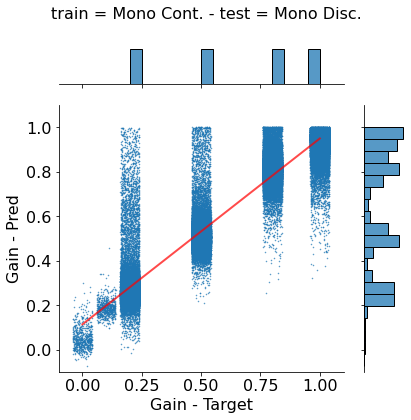

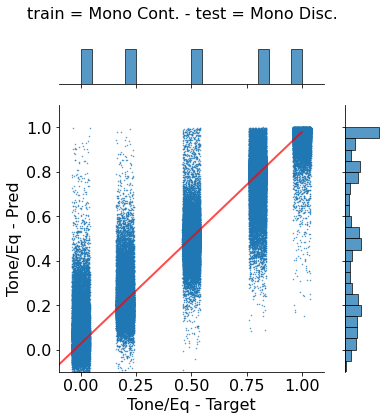

In [14]:
# SCATTER PLOT
# gain
ax = utils.scatter_plot(
    x="gain_targ", y="gain_pred", dataframe=test_df_mono_disc, 
    title='train = Mono Cont. - test = Mono Disc.', title_fontsize=16, 
    text_fontsize=16, xlabel='Gain - Target', ylabel='Gain - Pred'
)

ax.ax_marg_x.set_xlim(-0.1, 1.1)
ax.ax_marg_y.set_ylim(-0.1, 1.1)

# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnetcond_sp_gain_MC_MD.png'), format='png')

# tone/eq1
ax = utils.scatter_plot(
    x="tone_eq1_targ", y="tone_eq1_pred", dataframe=test_df_mono_disc, 
    title='train = Mono Cont. - test = Mono Disc.', title_fontsize=16, 
    text_fontsize=16, xlabel='Tone/Eq - Target', ylabel='Tone/Eq - Pred',
    bins=40
)

ax.ax_marg_x.set_xlim(-0.1, 1.1)
ax.ax_marg_y.set_ylim(-0.1, 1.1)

# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnetcond_sp_tone_MC_MD.png'), format='png')

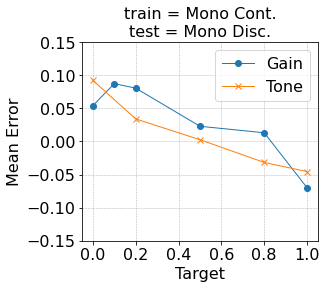

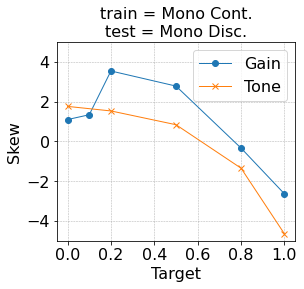

In [17]:
# MEAN ERROR and SKEW PLOTS
steps_gain = [0.0, 0.1, 0.2, 0.5, 0.8, 1.0]
steps_tone = [0.0, 0.2, 0.5, 0.8, 1.0]
avg_err_gain = []
avg_err_tone = []
skew_gain = []
skew_tone = []

for n in range(len(steps_gain)):
    df = test_df_mono_disc[test_df_mono_disc['gain_targ'] == steps_gain[n]]
    avg_err_gain.append(sum(df['gain_err']) / len(df))
    skew_gain.append(scipy.stats.skew(df['gain_err']))

for n in range(len(steps_tone)):
    df = test_df_mono_disc[test_df_mono_disc['tone_eq1_targ'] == steps_tone[n]]
    avg_err_tone.append(sum(df['tone_eq1_err']) / len(df))
    skew_tone.append(scipy.stats.skew(df['tone_eq1_err']))

# print(np.around(avg_err_gain,3))
# print(np.around(avg_err_tone,3))
# print(np.around(skew_gain,3))
# print(np.around(skew_tone,3))

# mean error
plt.figure(figsize=(4.8,4.3))
utils.line_plot(
    x_gain=steps_gain, x_tone=steps_tone, 
    y_gain=avg_err_gain, y_tone=avg_err_tone, 
    title='train = Mono Cont.\ntest = Mono Disc.' , title_fontsize=16, 
    text_fontsize=16, xlabel='Target', ylabel='Mean Error'
)

plt.xlim([-0.05, 1.05])
plt.ylim([-0.15, 0.15])
# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnetcond_me_MC_MD.eps'), format='eps')

# skew
plt.figure(figsize=(4.5,4.3))
utils.line_plot(
    x_gain=steps_gain, x_tone=steps_tone, 
    y_gain=skew_gain, y_tone=skew_tone, 
    title='train = Mono Cont.\ntest = Mono Disc.' , title_fontsize=16, 
    text_fontsize=16, xlabel='Target', ylabel='Skew'
)

plt.xlim([-0.05, 1.05])
plt.ylim([-5, 5])
# plt.savefig('%s/%s/%s' % (results_folder, 'figures', 'setnetcond_sk_MC_MD.eps'), format='eps')